In [1]:
!pip install matplotlib

In [2]:
import os
import PyPDF2
import re
import pandas as pd
pd.options.plotting.backend = "plotly"
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

# Función para extraer texto de un archivo PDF
def extraer_texto_de_pdf(archivo_pdf):
    try:
        with open(archivo_pdf, 'rb') as pdf_file:
            pdf_reader = PyPDF2.PdfReader(pdf_file)
            texto = ''
            for pagina in pdf_reader.pages:
                texto += pagina.extract_text()
            return texto
    except Exception as e:
        print(f"Error al extraer texto del PDF {archivo_pdf}: {str(e)}")
        return None

# Carpeta que contiene los archivos PDF
carpeta_pdf = os.path.join(os.getcwd(), 'movimientos')

# Lista para almacenar DataFrames de cada archivo PDF
dataframes = []

# Itera a través de los archivos PDF en la carpeta
for archivo in os.listdir(carpeta_pdf):
    if archivo.endswith('.pdf'):
        archivo_pdf = os.path.join(carpeta_pdf, archivo)
        texto_extraido = extraer_texto_de_pdf(archivo_pdf)
        if texto_extraido:
            # Procesa el texto extraído y crea un DataFrame
            lineas = texto_extraido.split('\n')
            filas_con_fecha = [linea.strip() for linea in lineas if re.match(r'\d{2}-\d{2}-\d{4}', linea)]
            fechas = []
            conceptos = []
            fechas_valor = []
            saldos = []
            ingresos_gastos = []

            for fila in filas_con_fecha:
                match = re.search(r'(\d{2}-\d{2}-\d{4})\s+(.*?)\s+(\d{2}-\d{2}-\d{4})\s+([\d,.]+ €)\s+(-?[\d,.]+)', fila)
                if match:
                    fechas.append(match.group(1))
                    conceptos.append(match.group(2))
                    fechas_valor.append(match.group(3))
                    saldos.append(match.group(4))
                    ingresos_gastos.append(match.group(5))

            df = pd.DataFrame({
                'Fecha': fechas,
                'Concepto': conceptos,
                'Fecha_Valor': fechas_valor,
                'Saldo': saldos,
                'Ingreso/Gasto': ingresos_gastos
            })
            dataframes.append(df)

# Concatena todos los DataFrames en uno solo
df_final = pd.concat(dataframes, ignore_index=True)

# Imprime el DataFrame final
df_final


,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto
0,31-03-2017,Traspaso emitido (SENDO MERCADONA),31-03-2017,"3.777,09 €","-8,39"
1,31-03-2017,Traspaso emitido (AHORRO LOGO,31-03-2017,"3.785,48 €","-140,00"
2,31-03-2017,Traspaso emitido (HOFFMAN BORJA),31-03-2017,"3.925,48 €","-21,00"
3,31-03-2017,Cargo cuota Seg. Social,31-03-2017,"3.946,48 €","-65,75"
4,30-03-2017,Traspaso emitido (SENDO HOFFMAN,30-03-2017,"4.012,23 €","-22,00"
5,30-03-2017,Traspaso emitido (AMEX LIBRO,30-03-2017,"4.034,23 €","-15,15"
6,30-03-2017,Traspaso emitido (AMEX GASOIL),30-03-2017,"4.049,38 €","-56,03"
7,30-03-2017,Traspaso emitido (SEGUROS),30-03-2017,"4.105,41 €","-78,66"
8,30-03-2017,Traspaso emitido (GYM VALEN),30-03-2017,"4.184,07 €","-22,90"
9,30-03-2017,Traspaso emitido (PARKING VALEN),30-03-2017,"4.206,97 €","-40,00"


In [3]:
df_final.dtypes


Fecha            object
Concepto         object
Fecha_Valor      object
Saldo            object
Ingreso/Gasto    object
dtype: object

In [4]:
df_final['Fecha'] = pd.to_datetime(df_final['Fecha'], format='%d-%m-%Y')

In [5]:
df_final['Fecha_valor'] = pd.to_datetime(df_final['Fecha_Valor'], format='%d-%m-%Y')

In [6]:
df_final.dtypes

Fecha            datetime64[ns]
Concepto                 object
Fecha_Valor              object
Saldo                    object
Ingreso/Gasto            object
Fecha_valor      datetime64[ns]
dtype: object

In [7]:
# Elimina todos los caracteres no numéricos de la columna 'Saldo' y divide entre 100
df_final['Saldo'] = df_final['Saldo'].str.replace('[^\d-]', '', regex=True).astype(float) / 100



<>:2: SyntaxWarning: invalid escape sequence '\d'
<>:2: SyntaxWarning: invalid escape sequence '\d'
/var/folders/8g/yj4fgsmn6q59m4_81r8zknph0000gn/T/ipykernel_66106/1340291051.py:2: SyntaxWarning: invalid escape sequence '\d'
  df_final['Saldo'] = df_final['Saldo'].str.replace('[^\d-]', '', regex=True).astype(float) / 100


In [8]:
df_final

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor
0,2017-03-31,Traspaso emitido (SENDO MERCADONA),31-03-2017,3777.09,"-8,39",2017-03-31
1,2017-03-31,Traspaso emitido (AHORRO LOGO,31-03-2017,3785.48,"-140,00",2017-03-31
2,2017-03-31,Traspaso emitido (HOFFMAN BORJA),31-03-2017,3925.48,"-21,00",2017-03-31
3,2017-03-31,Cargo cuota Seg. Social,31-03-2017,3946.48,"-65,75",2017-03-31
4,2017-03-30,Traspaso emitido (SENDO HOFFMAN,30-03-2017,4012.23,"-22,00",2017-03-30
5,2017-03-30,Traspaso emitido (AMEX LIBRO,30-03-2017,4034.23,"-15,15",2017-03-30
6,2017-03-30,Traspaso emitido (AMEX GASOIL),30-03-2017,4049.38,"-56,03",2017-03-30
7,2017-03-30,Traspaso emitido (SEGUROS),30-03-2017,4105.41,"-78,66",2017-03-30
8,2017-03-30,Traspaso emitido (GYM VALEN),30-03-2017,4184.07,"-22,90",2017-03-30
9,2017-03-30,Traspaso emitido (PARKING VALEN),30-03-2017,4206.97,"-40,00",2017-03-30


In [9]:
df_final['Ingreso/Gasto'] = df_final['Ingreso/Gasto'].str.replace('[^\d-]', '', regex=True).astype(float) / 100


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
/var/folders/8g/yj4fgsmn6q59m4_81r8zknph0000gn/T/ipykernel_66106/2591505125.py:1: SyntaxWarning: invalid escape sequence '\d'
  df_final['Ingreso/Gasto'] = df_final['Ingreso/Gasto'].str.replace('[^\d-]', '', regex=True).astype(float) / 100


In [10]:
df_final

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor
0,2017-03-31,Traspaso emitido (SENDO MERCADONA),31-03-2017,3777.09,-8.39,2017-03-31
1,2017-03-31,Traspaso emitido (AHORRO LOGO,31-03-2017,3785.48,-140.00,2017-03-31
2,2017-03-31,Traspaso emitido (HOFFMAN BORJA),31-03-2017,3925.48,-21.00,2017-03-31
3,2017-03-31,Cargo cuota Seg. Social,31-03-2017,3946.48,-65.75,2017-03-31
4,2017-03-30,Traspaso emitido (SENDO HOFFMAN,30-03-2017,4012.23,-22.00,2017-03-30
5,2017-03-30,Traspaso emitido (AMEX LIBRO,30-03-2017,4034.23,-15.15,2017-03-30
6,2017-03-30,Traspaso emitido (AMEX GASOIL),30-03-2017,4049.38,-56.03,2017-03-30
7,2017-03-30,Traspaso emitido (SEGUROS),30-03-2017,4105.41,-78.66,2017-03-30
8,2017-03-30,Traspaso emitido (GYM VALEN),30-03-2017,4184.07,-22.90,2017-03-30
9,2017-03-30,Traspaso emitido (PARKING VALEN),30-03-2017,4206.97,-40.00,2017-03-30


In [11]:
df_final.dtypes

Fecha            datetime64[ns]
Concepto                 object
Fecha_Valor              object
Saldo                   float64
Ingreso/Gasto           float64
Fecha_valor      datetime64[ns]
dtype: object

In [12]:
# Crear una columna 'Ingresos' y una columna 'Gastos'
df_final['Ingresos'] = df_final['Ingreso/Gasto'].apply(lambda x: x if x >= 0 else 0)
df_final['Gastos'] = df_final['Ingreso/Gasto'].apply(lambda x: -x if x < 0 else 0)


df_final


,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,Gastos
0,2017-03-31,Traspaso emitido (SENDO MERCADONA),31-03-2017,3777.09,-8.39,2017-03-31,0.00,8.39
1,2017-03-31,Traspaso emitido (AHORRO LOGO,31-03-2017,3785.48,-140.00,2017-03-31,0.00,140.00
2,2017-03-31,Traspaso emitido (HOFFMAN BORJA),31-03-2017,3925.48,-21.00,2017-03-31,0.00,21.00
3,2017-03-31,Cargo cuota Seg. Social,31-03-2017,3946.48,-65.75,2017-03-31,0.00,65.75
4,2017-03-30,Traspaso emitido (SENDO HOFFMAN,30-03-2017,4012.23,-22.00,2017-03-30,0.00,22.00
5,2017-03-30,Traspaso emitido (AMEX LIBRO,30-03-2017,4034.23,-15.15,2017-03-30,0.00,15.15
6,2017-03-30,Traspaso emitido (AMEX GASOIL),30-03-2017,4049.38,-56.03,2017-03-30,0.00,56.03
7,2017-03-30,Traspaso emitido (SEGUROS),30-03-2017,4105.41,-78.66,2017-03-30,0.00,78.66
8,2017-03-30,Traspaso emitido (GYM VALEN),30-03-2017,4184.07,-22.90,2017-03-30,0.00,22.90
9,2017-03-30,Traspaso emitido (PARKING VALEN),30-03-2017,4206.97,-40.00,2017-03-30,0.00,40.00


In [13]:
valores_unicos_concepto = df_final['Concepto'].unique()
print(valores_unicos_concepto)

['Traspaso emitido (SENDO MERCADONA)' 'Traspaso emitido (AHORRO LOGO'
 'Traspaso emitido (HOFFMAN BORJA)' ...
 'Traspaso recibido (REVISIÓN TOYOTA)' 'Pago RECAMBIOS MAJADAHONDA'
 'Transferencia emitida (FACTURA']


In [14]:
df_final['detalle'] = df_final['Concepto'].copy()
df_final

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,Gastos,detalle
0,2017-03-31,Traspaso emitido (SENDO MERCADONA),31-03-2017,3777.09,-8.39,2017-03-31,0.00,8.39,Traspaso emitido (SENDO MERCADONA)
1,2017-03-31,Traspaso emitido (AHORRO LOGO,31-03-2017,3785.48,-140.00,2017-03-31,0.00,140.00,Traspaso emitido (AHORRO LOGO
2,2017-03-31,Traspaso emitido (HOFFMAN BORJA),31-03-2017,3925.48,-21.00,2017-03-31,0.00,21.00,Traspaso emitido (HOFFMAN BORJA)
3,2017-03-31,Cargo cuota Seg. Social,31-03-2017,3946.48,-65.75,2017-03-31,0.00,65.75,Cargo cuota Seg. Social
4,2017-03-30,Traspaso emitido (SENDO HOFFMAN,30-03-2017,4012.23,-22.00,2017-03-30,0.00,22.00,Traspaso emitido (SENDO HOFFMAN
5,2017-03-30,Traspaso emitido (AMEX LIBRO,30-03-2017,4034.23,-15.15,2017-03-30,0.00,15.15,Traspaso emitido (AMEX LIBRO
6,2017-03-30,Traspaso emitido (AMEX GASOIL),30-03-2017,4049.38,-56.03,2017-03-30,0.00,56.03,Traspaso emitido (AMEX GASOIL)
7,2017-03-30,Traspaso emitido (SEGUROS),30-03-2017,4105.41,-78.66,2017-03-30,0.00,78.66,Traspaso emitido (SEGUROS)
8,2017-03-30,Traspaso emitido (GYM VALEN),30-03-2017,4184.07,-22.90,2017-03-30,0.00,22.90,Traspaso emitido (GYM VALEN)
9,2017-03-30,Traspaso emitido (PARKING VALEN),30-03-2017,4206.97,-40.00,2017-03-30,0.00,40.00,Traspaso emitido (PARKING VALEN)


In [15]:
valores_unicos_concepto = df_final['Concepto'].nunique()
print(f"Total de valores únicos en la columna 'Concepto': {valores_unicos_concepto}")

Total de valores únicos en la columna 'Concepto': 2900


In [16]:
# Reemplaza "mercadona" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmercadona\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "carrefour" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcarrefour\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "gasolina" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgasolina\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "gasoil" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgasoil\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "seguro" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bseguro\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "ahorro" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bahorro\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "hipercor" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bhipercor\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "caballo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcaballo\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "farmacia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfarmacia\b', case=False, regex=True), 'Concepto'] = 'farmacia'
# Reemplaza "olivia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bolivia\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "Mutua" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmutua\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "Primor" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bprimor\b', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "Zara" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bzara\b', case=False, regex=True), 'Concepto'] = 'Moda'
# Reemplaza "pelu" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bpelu\b', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "parking" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bparking\b', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "parking" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgym\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "rejas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\brejas\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "forus" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bforus\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "fitup" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfitup\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "pilates" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bpilates\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "financiera" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfinanciera\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "Corte" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcorte\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "supersol" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsupersol\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "dia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bdia\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "mapfre" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmapfre\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "sanitas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsanitas\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "alegria" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\balegria\b', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "arcipreste" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\barcipreste\b', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "alquiler" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\balquiler\b', case=False, regex=True), 'Concepto'] = 'alquiler'
# Reemplaza "vips" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bvips\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bbotox\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "restaurante" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\brestaurante\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "primark" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bprimark\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "amazon" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bamazon\b', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "mirela" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmirela\b', case=False, regex=True), 'Concepto'] = 'limpieza'
# Reemplaza "aparcamiento" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\baparcamiento\b', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "omega" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bomega\b', case=False, regex=True), 'Concepto'] = 'farmacia'
# Reemplaza "ginos" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bginos\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "descanso" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bdescanso\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "parte" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bparte\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "renfe" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\brenfe\b', case=False, regex=True), 'Concepto'] = 'movilidad'
# Reemplaza "comida" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bamex comida\b', case=False, regex=True), 'Concepto'] = 'restaurantes'

# Reemplaza "Aldi" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\baldi\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "viaje" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bviaje\b', case=False, regex=True), 'Concepto'] = 'viajes'
# Reemplaza "E.S." en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\be.s.\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "salamanca" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsalamanca\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "galp" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgalp\b', case=False, regex=True), 'Concepto'] = 'otros abonos'
# Reemplaza "kiosko" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bkiosko\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "bar" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bbar\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "cena" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcena\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "regalos" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bregalo\b', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "cumple" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcumple\b', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "social" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsocial\b', case=False, regex=True), 'Concepto'] = 'limpieza'
# Reemplaza "ropa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bropa\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "atencion" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\batencion\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "logo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\blogo\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "intensivo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bintensivo\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "1 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b1 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "2 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b2 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "3 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b3 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "4 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b4 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "5 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b5 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "6 de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\b6 de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "dos de" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bdos de\b', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "terapias" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bterapias\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "ee.ss" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bee.ss\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "alcampo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\balcampo\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "decathlon" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bdecathlon\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "HM" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bHM\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "supercor" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsupercor\b', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "leroy" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bleroy\b', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "oh" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\boh\b', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "somato" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsomatopilates\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "valle del" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bvalle del\b', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "valle" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bvalle\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "cajero" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcajero\b', case=False, regex=True), 'Concepto'] = 'efectivo'
# Reemplaza "loteria" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bloteria\b', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "la" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bla\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "el" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bel\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "impuesto" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bimpuesto\b', case=False, regex=True), 'Concepto'] = 'impuestos'
# Reemplaza "impuestos" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bimpuestos\b', case=False, regex=True), 'Concepto'] = 'impuestos'
# Reemplaza "hipoteca" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bhipoteca\b', case=False, regex=True), 'Concepto'] = 'hipoteca'
# Reemplaza "tarjeta" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\btarjeta\b', case=False, regex=True), 'Concepto'] = 'tarjetas'
# Reemplaza "american" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bamerican\b', case=False, regex=True), 'Concepto'] = 'tarjetas'
# Reemplaza "nómina" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bnómina\b', case=False, regex=True), 'Concepto'] = 'tarjetas'
# Reemplaza "colegio" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcolegio\b', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "areteia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bareteia\b', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "jauja" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bjauja\b', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "vero" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bvero\b', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "cafeteria" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcafeteria\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "cafe" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcafe\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "fcia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfcia\b', case=False, regex=True), 'Concepto'] = 'farmacia'
# Reemplaza "ahorramas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bahorramas\b', case=False, regex=True), 'Concepto'] = 'comida'

# Reemplaza "telefonica" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\btelefonica\b', case=False, regex=True), 'Concepto'] = 'movil_internet'
# Reemplaza "yoigo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\byoigo\b', case=False, regex=True), 'Concepto'] = 'movil_internet'
# Reemplaza "jazztel" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bjazztel\b', case=False, regex=True), 'Concepto'] = 'movil_internet'
# Reemplaza "isabel otero" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\botero\b', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "isabel" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bisabel\b', case=False, regex=True), 'Concepto'] = 'agua'
# Reemplaza "iberdrola" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\biberdrola\b', case=False, regex=True), 'Concepto'] = 'energia'
# Reemplaza "gas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgas\b', case=False, regex=True), 'Concepto'] = 'energia'
# Reemplaza "verde" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bverde\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "verdecora" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bverdecora\b', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "ayto" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bayto\b', case=False, regex=True), 'Concepto'] = 'impuestos'
# Reemplaza "ayuntamiento" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bayuntamiento\b', case=False, regex=True), 'Concepto'] = 'impuestos'
# Reemplaza "alara" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\balara\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "cinesa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcinesa\b', case=False, regex=True), 'Concepto'] = 'ocio'
# Reemplaza "cine" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcine\b', case=False, regex=True), 'Concepto'] = 'ocio'
# Reemplaza "fitness" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfitness\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "padel" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bpadel\b', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "calzados" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcalzados\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "calzados" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bcalzados\b', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "calzados" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\blas rozas\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "zapa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'zapa', case=False, regex=True), 'Concepto'] = 'moda'
# Reemplaza "zapa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'pelu', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "disn" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'disn', case=False, regex=True), 'Concepto'] = 'viajes'
# Reemplaza "coche" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'coche', case=False, regex=True), 'Concepto'] = 'coches'
# Reemplaza "toyo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'toyo', case=False, regex=True), 'Concepto'] = 'coches'
# Reemplaza "super" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'super', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "uñas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'uñas', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "plaza" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'plaz', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "victoria" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'victoria', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "medicos" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'medico', case=False, regex=True), 'Concepto'] = 'ong'
# Reemplaza "team" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'team', case=False, regex=True), 'Concepto'] = 'ong'
# Reemplaza "santander" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'santander', case=False, regex=True), 'Concepto'] = 'coches'
# Reemplaza "gasolinera" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'gasolinera', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "deporte" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'depor', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "campamento" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'campamento', case=False, regex=True), 'Concepto'] = 'ocio'
# Reemplaza "camp" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'camp', case=False, regex=True), 'Concepto'] = 'comida'
# Reemplaza "pizz" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'pizz', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "expen" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'expen', case=False, regex=True), 'Concepto'] = 'ocio'
# Reemplaza "telpark" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'telp', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "nails" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'nail', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "susana" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'susa', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "pk" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'pk', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "peaje" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'peaj', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "pulsa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'pulsa', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "MJ" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'mamá', case=False, regex=True), 'Concepto'] = 'MJ'
# Reemplaza "resto" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'resto', case=False, regex=True), 'Concepto'] = 'ahorro'
# Reemplaza "hiper" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'hiper', case=False, regex=True), 'Concepto'] = 'gastos_compras'
# Reemplaza "home" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'home', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "grana" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'grana', case=False, regex=True), 'Concepto'] = 'viajes'
# Reemplaza "mia" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'mia', case=False, regex=True), 'Concepto'] = 'viajes'
# Reemplaza "Oli" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\boli\b', case=False, regex=True), 'Concepto'] = 'Gastos/ingreso_oli'
# Reemplaza "valen" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bvalen\b', case=False, regex=True), 'Concepto'] = 'Gastos/ingreso_valen'
# Reemplaza "sendo altea" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsendo altea\b', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "sendo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bsendo\b', case=False, regex=True), 'Concepto'] = 'gastos_varios'
# Reemplaza "amex" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bamex\b', case=False, regex=True), 'Concepto'] = 'gastos_varios'
# Reemplaza "relampago" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\brelampago\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "tony" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\btony\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "revisi" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'revisi', case=False, regex=True), 'Concepto'] = 'coches'
# Reemplaza "revisi" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'roma', case=False, regex=True), 'Concepto'] = 'coches'
# Reemplaza "ensaladas" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bensaladas\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
#
# Reemplaza "food" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bfood\b', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "card" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'card', case=False, regex=True), 'Concepto'] = 'tarjetas'
# Reemplaza "hotel" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'hotel', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "kios" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'kios', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "bizum" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bbizum\b', case=False, regex=True), 'Concepto'] = 'gastos_varios'
# Reemplaza "garaje" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bgaraje\b', case=False, regex=True), 'Concepto'] = 'parking'
df_final.loc[df_final['Gastos'] == 1050.00, 'Concepto'] = 'Alquiler'
# Reemplaza "comasa" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'comasa', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "c 794" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'c794', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "mcdonalds" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'mcdonalds', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "fit" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'fit', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "e3012" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'E3012', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "e3012" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'gasov', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "garaje" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmajadahonda majadahonda\b', case=False, regex=True), 'Concepto'] = 'gasolina'
# Reemplaza "beaut" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'beaut', case=False, regex=True), 'Concepto'] = 'belleza'
# Reemplaza "donalds" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'donalds', case=False, regex=True), 'Concepto'] = 'restaurantes'
# Reemplaza "conmigo" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'conmigo', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "majadahonda" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bmajadahonda\b', case=False, regex=True), 'Concepto'] = 'gastos_varios'
# Reemplaza "metro" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'metro', case=False, regex=True), 'Concepto'] = 'movilidad'
df_final.loc[df_final['Gastos'] == 45.60, 'Concepto'] = 'autonomo'
# Reemplaza "madr" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'madr', case=False, regex=True), 'Concepto'] = 'gastos_varios'
(df_final['Gastos'] == 50.00) & (df_final['Concepto'].str.contains(r'\btraspaso emitido\b', case=False, regex=True))

0        False
1        False
2        False
3        False
4        False
5        False
6        False
7        False
8        False
9        False
10       False
11        True
12       False
13       False
14       False
15       False
16       False
17       False
18       False
19       False
20       False
21       False
22       False
23       False
24       False
25       False
26       False
27       False
28       False
29       False
30       False
31       False
32       False
33       False
34       False
35       False
36       False
37       False
38       False
39       False
40       False
41       False
42       False
43       False
44       False
45       False
46       False
47       False
48       False
49       False
50       False
51       False
52       False
53       False
54       False
55       False
56       False
57       False
58       False
59       False
60       False
61       False
62       False
63       False
64       False
65       False
66       F

In [17]:
# Reemplaza "seguros" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\bseguros\b', case=False, regex=True), 'Concepto'] = 'seguros'
# Reemplaza "traspaso" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'\btraspaso\b', case=False, regex=True), 'Concepto'] = 'movimientos_interno'
# Reemplaza "loter" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'loter', case=False, regex=True), 'Concepto'] = 'loteria'
# Reemplaza "pago" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'pago', case=False, regex=True), 'Concepto'] = 'pago_con_tarjeta'
# Reemplaza "volks" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'volks', case=False, regex=True), 'Concepto'] = 'coche'
# Reemplaza "animal" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'animal', case=False, regex=True), 'Concepto'] = 'terapiasOli'
# Reemplaza "estudio" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'estudio', case=False, regex=True), 'Concepto'] = 'oposiciones'
# Reemplaza "jazz" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'jazz', case=False, regex=True), 'Concepto'] = 'movil_internet'
# Reemplaza "cofi" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'cofi', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "gopad" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'gopa', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "escuela" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'escue', case=False, regex=True), 'Concepto'] = 'gym'
# Reemplaza "comunidad" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'comunidad', case=False, regex=True), 'Concepto'] = 'casa'
# Reemplaza "vinci" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'vinci', case=False, regex=True), 'Concepto'] = 'parking'
# Reemplaza "orange" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'orange', case=False, regex=True), 'Concepto'] = 'movil_internet'
# Reemplaza "esther" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'esther', case=False, regex=True), 'Concepto'] = 'colegios'
# Reemplaza "mentema" en la columna "Concepto" de todas las filas donde aparece
df_final.loc[df_final['Concepto'].str.contains(r'mentema', case=False, regex=True), 'Concepto'] = 'gym'


In [18]:
condicion = (df_final['Gastos'] == 50.00) & (df_final['Concepto'].str.contains(r'\btraspaso emitido\b', case=False, regex=True))
df_final.loc[condicion, 'Concepto'] = 'ahorro'


In [19]:
valores_unicos_concepto = df_final['Concepto'].nunique()
print(f"Total de valores únicos en la columna 'Concepto': {valores_unicos_concepto}")



Total de valores únicos en la columna 'Concepto': 207


In [20]:
filas_1 = df_final[df_final['Concepto'].str.contains(r'\btraspaso\b', case=False, regex=True)]
filas_1

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,Gastos,detalle


In [21]:
filas_1 = df_final[df_final['Concepto'].str.contains(r'recibo', case=False, regex=True)]
filas_1

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,Gastos,detalle
217,2017-01-01,Abono por domiciliación recibos,01-01-2017,3106.36,7.15,2017-01-01,7.15,0.00,Abono por domiciliación recibos
632,2021-02-09,Recibo NATIONALE NEDERLANDEN,09-02-2021,490.90,-438.90,2021-02-09,0.00,438.90,Recibo NATIONALE NEDERLANDEN
1397,2022-02-09,Recibo NATIONALE NEDERLANDEN,09-02-2022,297.50,-456.57,2022-02-09,0.00,456.57,Recibo NATIONALE NEDERLANDEN
1583,2013-06-01,Abono por domiciliación recibos,01-06-2013,1664.56,3.73,2013-06-01,3.73,0.00,Abono por domiciliación recibos
1652,2013-05-01,Abono por domiciliación recibos,01-05-2013,1870.75,2.03,2013-05-01,2.03,0.00,Abono por domiciliación recibos
1710,2013-04-04,Recibo Xfera Moviles S.A.,04-04-2013,2412.27,-83.53,2013-04-04,0.00,83.53,Recibo Xfera Moviles S.A.
1727,2013-04-01,Abono por domiciliación recibos,01-04-2013,2065.52,6.06,2013-04-01,6.06,0.00,Abono por domiciliación recibos
1779,2013-03-01,Abono por domiciliación recibos,01-03-2013,1371.85,2.47,2013-03-01,2.47,0.00,Abono por domiciliación recibos
1840,2013-02-01,Abono por domiciliación recibos,01-02-2013,1454.22,7.50,2013-02-01,7.50,0.00,Abono por domiciliación recibos
1896,2013-01-04,Recibo Xfera Moviles S.A.,04-01-2013,1696.92,-66.67,2013-01-04,0.00,66.67,Recibo Xfera Moviles S.A.


In [22]:
filas_1050 = df_final[df_final['Gastos'] == 50.00]
filas_1050

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,Gastos,detalle
11,2017-03-30,movimientos_interno,30-03-2017,4288.97,-50.0,2017-03-30,0.0,50.0,Traspaso emitido (PAGO FINAL HAB
88,2017-02-28,movimientos_interno,28-02-2017,4691.02,-50.0,2017-02-28,0.0,50.0,Traspaso emitido (PAGO 3 HABITACION
108,2017-02-13,belleza,13-02-2017,248.44,-50.0,2017-02-13,0.0,50.0,Traspaso emitido (SENDO PRIMOR)
145,2017-01-31,movimientos_interno,31-01-2017,3301.13,-50.0,2017-01-31,0.0,50.0,Traspaso emitido (2-4 HABITACIÓN
180,2017-01-11,movimientos_interno,11-01-2017,234.98,-50.0,2017-01-11,0.0,50.0,Traspaso emitido (PRIMER PAGO
230,2021-12-28,ahorro,28-12-2021,2387.06,-50.0,2021-12-28,0.0,50.0,Traspaso emitido (6 DE 6 ALISADO)
268,2021-12-20,gastos_varios,20-12-2021,186.59,-50.0,2021-12-20,0.0,50.0,Traspaso BIZUM emitido
352,2021-12-04,gastos_varios,04-12-2021,1755.49,-50.0,2021-12-04,0.0,50.0,Traspaso BIZUM emitido
358,2021-12-03,ahorro,03-12-2021,1929.24,-50.0,2021-12-03,0.0,50.0,Traspaso emitido (5 DE 6 ALISADO)
362,2021-12-02,efectivo,02-12-2021,2096.24,-50.0,2021-12-02,0.0,50.0,Reintegro Cajero ING BANK


In [23]:
valores_unicos_concepto = df_final['Concepto'].unique().tolist()
valores_unicos_concepto


['comida',
 'ahorro',
 'movimientos_interno',
 'limpieza',
 'gastos_varios',
 'gasolina',
 'seguros',
 'gym',
 'parking',
 'tarjetas',
 'farmacia',
 'moda',
 'gastos_compras',
 'Transferencia recibida',
 'Moda',
 'agua',
 'belleza',
 'restaurantes',
 'energia',
 'colegios',
 'Transferencia emitida (JAMONCITO',
 'coches',
 'movil_internet',
 'ong',
 'terapiasOli',
 'Alquiler',
 'casa',
 'Transferencia emitida (MARZO)',
 'ocio',
 'Transferencia emitida (DEVOLUCIÓN)',
 'Transferencia emitida (FEBRERO)',
 'Gastos/ingreso_oli',
 'Ingreso pensión (INGRESO PENSIÓN)',
 'Transferencia emitida (MULTA)',
 'movilidad',
 'Abono por domiciliación recibos',
 'pago_con_tarjeta',
 'efectivo',
 'loteria',
 'coche',
 'oposiciones',
 'hipoteca',
 'MJ',
 'viajes',
 'impuestos',
 'Transferencia emitida (TERAPIA',
 'Recibo NATIONALE NEDERLANDEN',
 'Gastos/ingreso_valen',
 'Abono prestación Desempleo',
 'Ingreso pensión (PENSION SEGURIDAD',
 'autonomo',
 'Transferencia emitida (ACTIVIDAD',
 'Transferencia emi

In [24]:
df_final = df_final.sort_values(by='Fecha', ascending=True).reset_index(drop=True)


In [25]:
incomes = df_final.copy()

In [26]:
expences= df_final.copy()

In [27]:
incomes = incomes.drop(columns=['Gastos'])
incomes = incomes[incomes['Ingresos'] != 0]

In [28]:
incomes

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,detalle
0,2012-10-05,Transferencia recibida (TRANSFERENCIA,05-10-2012,1500.00,1500.00,2012-10-05,1500.00,Transferencia recibida (TRANSFERENCIA
1,2012-10-30,alquiler,30-10-2012,2436.79,1025.22,2012-10-30,1025.22,Transferencia recibida (ALQUILER MAS
4,2012-10-31,Abono BP,30-10-2012,2428.16,1.37,2012-10-30,1.37,Abono BP
8,2012-11-02,movimientos_interno,02-11-2012,3087.54,750.00,2012-11-02,750.00,Traspaso periódico recibido (SPO FROM
17,2012-11-05,Abono BP,04-11-2012,1028.88,1.56,2012-11-04,1.56,Abono BP
19,2012-11-05,Transferencia recibida (TRANSFERENCIA,05-11-2012,2910.31,289.00,2012-11-05,289.00,Transferencia recibida (TRANSFERENCIA
21,2012-11-06,Transferencia recibida (TRANSFERENCIA,06-11-2012,1053.88,25.00,2012-11-06,25.00,Transferencia recibida (TRANSFERENCIA
32,2012-11-14,Transferencia recibida,14-11-2012,505.30,110.00,2012-11-14,110.00,Transferencia recibida
40,2012-11-20,Abono BP,19-11-2012,213.03,0.69,2012-11-19,0.69,Abono BP
41,2012-11-22,Transferencia recibida (TRANSFERENCIA,22-11-2012,273.03,60.00,2012-11-22,60.00,Transferencia recibida (TRANSFERENCIA


In [29]:
incomes.describe()

,Fecha,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos
count,2482,2482.000000,2482.000000,2482,2482.000000
mean,2018-12-20 02:23:53.037872640,2366.433400,1042.544964,2018-12-20 00:59:45.495568128,1042.544964
min,2012-10-05 00:00:00,0.000000,0.010000,2012-10-05 00:00:00,0.010000
25%,2016-04-04 06:00:00,577.352500,60.000000,2016-04-05 00:00:00,60.000000
50%,2019-07-02 00:00:00,1361.035000,155.000000,2019-07-02 00:00:00,155.000000
75%,2021-09-29 18:00:00,2303.495000,750.000000,2021-09-29 18:00:00,750.000000
max,2023-10-08 00:00:00,401267.560000,318284.000000,2023-10-08 00:00:00,318284.000000
std,NaN,10917.586741,8270.504408,NaN,8270.504408


In [30]:
incomes['Ingresos'].median()

155.0

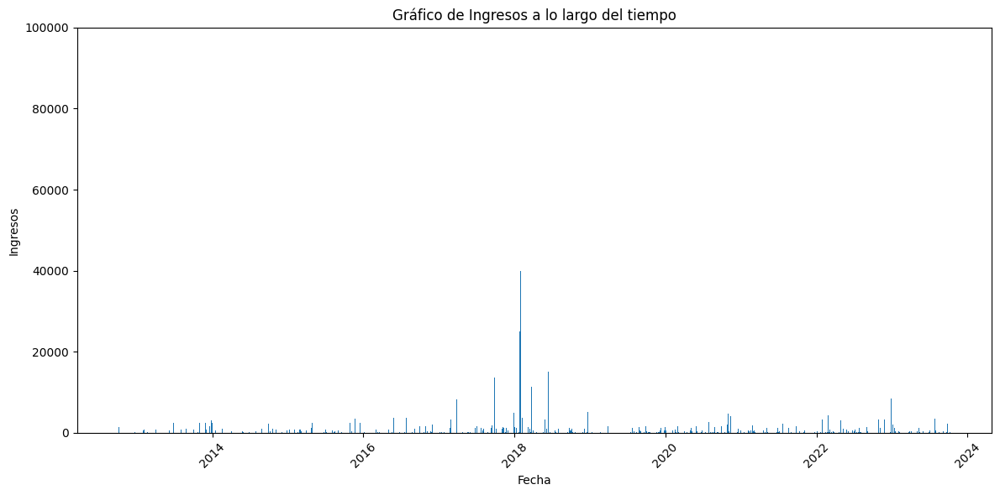

In [31]:
import matplotlib.pyplot as plt

# Configurar el tamaño del gráfico
plt.figure(figsize=(12, 6))

# Establecer los valores de X e Y
fechas = incomes['Fecha']
ingresos = incomes['Ingresos']

# Crear el gráfico de barras
plt.bar(fechas, ingresos)

# Configurar los límites del eje Y
plt.ylim(0, 100000)

# Rotar las etiquetas del eje X para una mejor visualización
plt.xticks(rotation=45)

# Etiquetas y título
plt.xlabel('Fecha')
plt.ylabel('Ingresos')
plt.title('Gráfico de Ingresos a lo largo del tiempo')

# Mostrar el gráfico
plt.tight_layout()
plt.show()


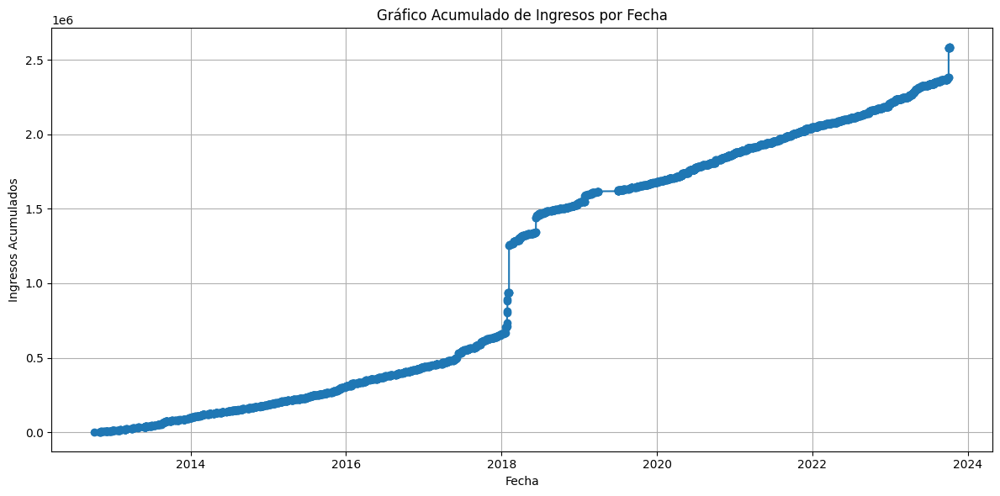

In [33]:
import matplotlib.pyplot as plt

# Crear una nueva columna "Ingresos Acumulados"
incomes['Ingresos Acumulados'] = incomes['Ingresos'].cumsum()

# Crear el gráfico de ingresos acumulados
plt.figure(figsize=(12, 6))
plt.plot(incomes['Fecha'], incomes['Ingresos Acumulados'], marker='o', linestyle='-')

# Etiquetas y título
plt.xlabel('Fecha')
plt.ylabel('Ingresos Acumulados')
plt.title('Gráfico Acumulado de Ingresos por Fecha')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()


/Users/valentincortespuya/anaconda3/envs/scrapeo/lib/python3.12/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  v = v.dt.to_pydatetime()


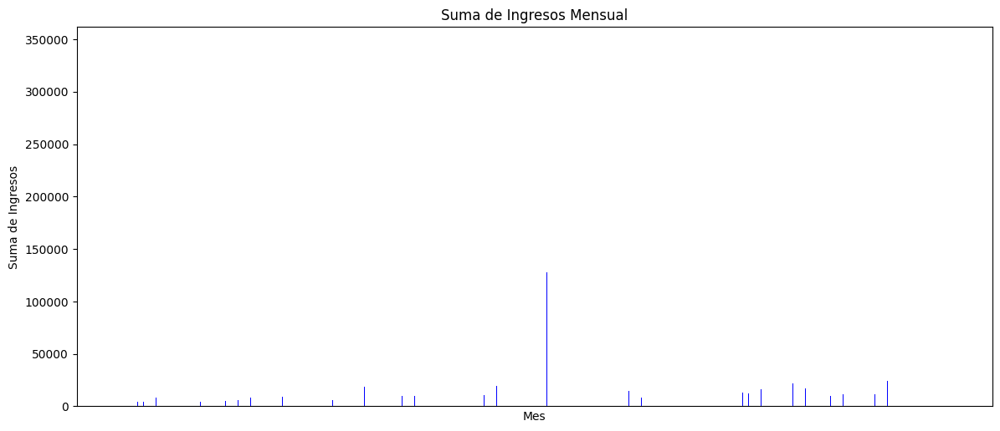

In [36]:
import matplotlib.pyplot as plt
import pandas as pd

incomes['Fecha'] = pd.to_datetime(incomes['Fecha'])

monthly_incomes = incomes.resample('M', on='Fecha')['Ingresos'].sum()

plt.figure(figsize=(12, 6))
monthly_incomes.plot(kind='bar')  # Elimina el parámetro color
plt.xlabel('Mes')
plt.ylabel('Suma de Ingresos')
plt.title('Suma de Ingresos Mensual')
plt.xticks(range(len(monthly_incomes)), [str(month.month_name()) for month in monthly_incomes.index], rotation=45)
plt.tight_layout()

# Establecer el color de las barras en azul utilizando Matplotlib
plt.bar(monthly_incomes.index, monthly_incomes, color='blue')

plt.show()





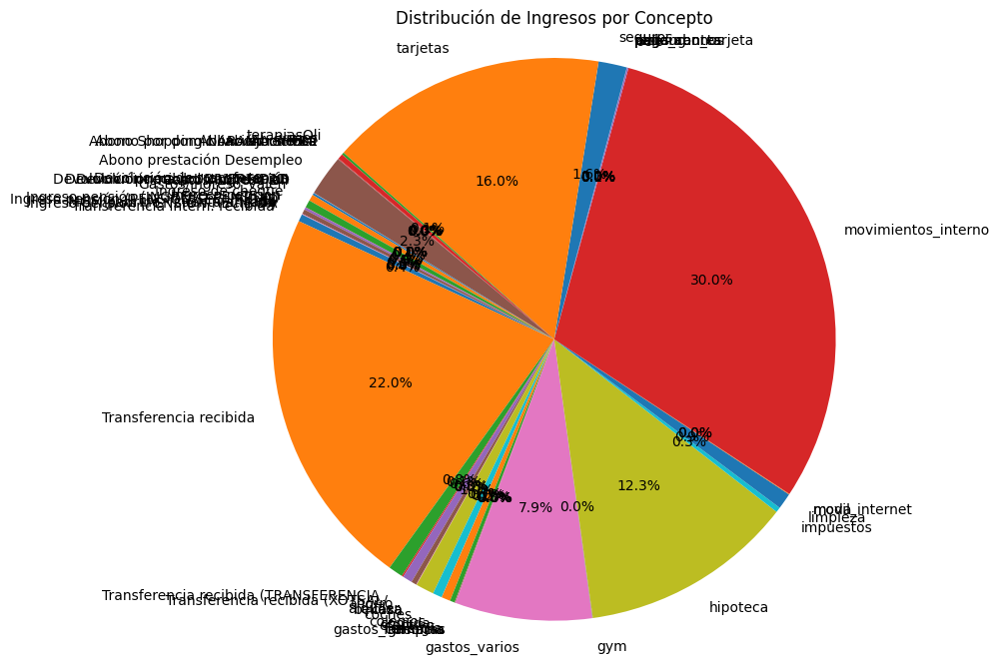

In [37]:
import matplotlib.pyplot as plt

# Agrupa los ingresos por Concepto y suma los valores
concepto_sum = incomes.groupby('Concepto')['Ingresos'].sum()

# Crea un gráfico de pastel
plt.figure(figsize=(8, 8))
plt.pie(concepto_sum, labels=concepto_sum.index, autopct='%1.1f%%', startangle=140)

# Título
plt.title('Distribución de Ingresos por Concepto')

# Muestra el gráfico
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


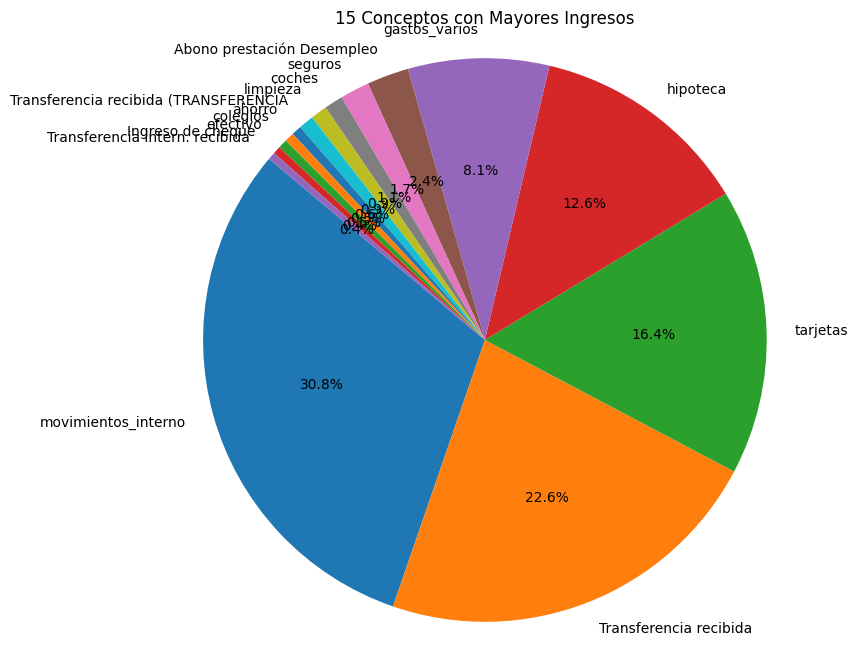

In [38]:
import matplotlib.pyplot as plt

# Agrupa los ingresos por Concepto y suma los valores
concepto_sum = incomes.groupby('Concepto')['Ingresos'].sum()

# Ordena los conceptos por suma de ingresos de mayor a menor
concepto_sum = concepto_sum.sort_values(ascending=False)

# Toma los 15 conceptos más grandes
top_15_conceptos = concepto_sum.head(15)

# Crea un gráfico de pastel
plt.figure(figsize=(8, 8))
plt.pie(top_15_conceptos, labels=top_15_conceptos.index, autopct='%1.1f%%', startangle=140)

# Título
plt.title('15 Conceptos con Mayores Ingresos')

# Muestra el gráfico
plt.axis('equal')
plt.show()


In [39]:
expences = expences.drop(columns=['Ingresos'])
expences = expences[expences['Gastos'] != 0]

In [40]:
expences.describe()

,Fecha,Saldo,Ingreso/Gasto,Fecha_valor,Gastos
count,10305,10305.000000,10305.000000,10305,10305.000000
mean,2019-02-10 02:25:36.419213824,1620.782660,-251.932438,2019-02-10 00:41:30.131004416,251.932438
min,2012-10-30 00:00:00,0.000000,-374000.000000,2012-10-30 00:00:00,0.010000
25%,2016-10-01 00:00:00,486.580000,-94.110000,2016-10-01 00:00:00,13.500000
50%,2019-09-02 00:00:00,1035.350000,-39.300000,2019-09-02 00:00:00,39.300000
75%,2021-10-01 00:00:00,1898.050000,-13.500000,2021-10-01 00:00:00,94.110000
max,2023-10-08 00:00:00,377282.670000,-0.010000,2023-10-08 00:00:00,374000.000000
std,NaN,6144.568243,4406.082256,NaN,4406.082256


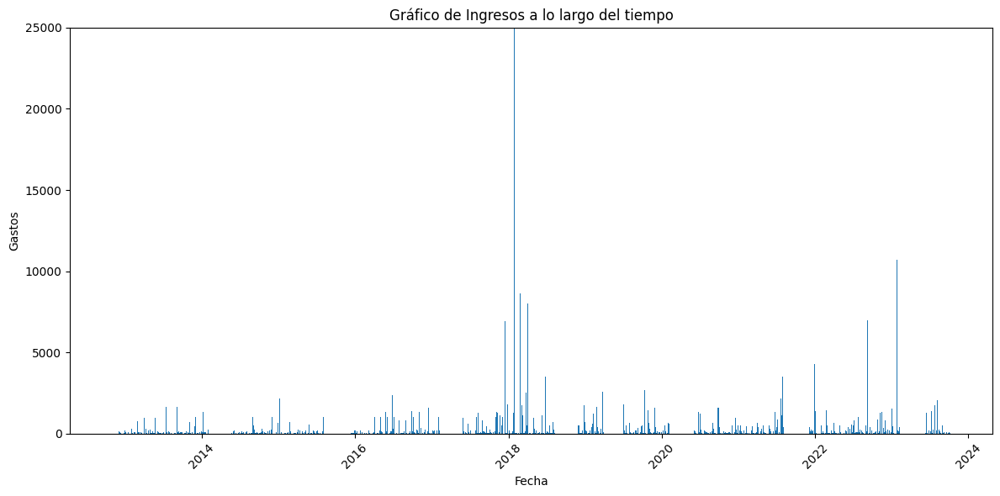

In [41]:
import matplotlib.pyplot as plt

# Configurar el tamaño del gráfico
plt.figure(figsize=(12, 6))

# Establecer los valores de X e Y
fechas = expences['Fecha']
ingresos = expences['Gastos']

# Crear el gráfico de barras
plt.bar(fechas, ingresos)

# Configurar los límites del eje Y
plt.ylim(0, 25000)

# Rotar las etiquetas del eje X para una mejor visualización
plt.xticks(rotation=45)

# Etiquetas y título
plt.xlabel('Fecha')
plt.ylabel('Gastos')
plt.title('Gráfico de Ingresos a lo largo del tiempo')

# Mostrar el gráfico
plt.tight_layout()
plt.show()


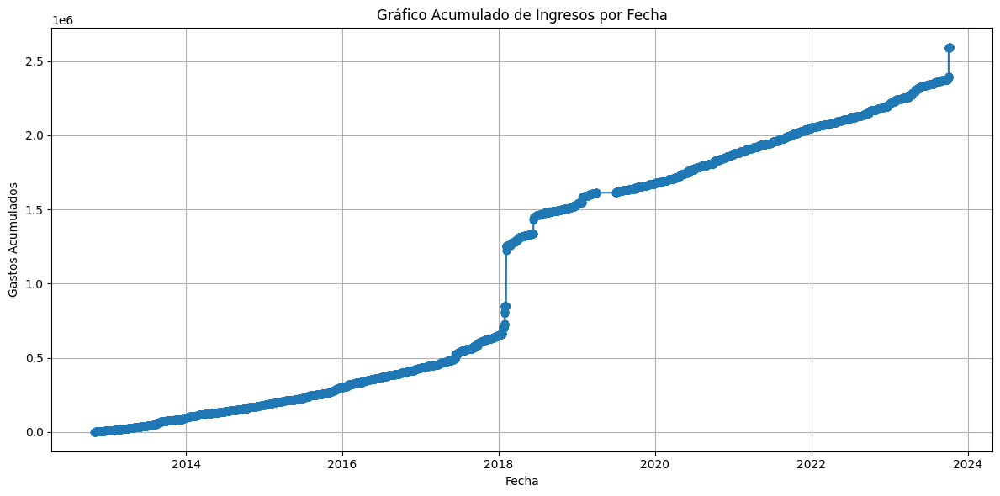

In [42]:
import matplotlib.pyplot as plt

# Crear una nueva columna "gastos acumulados
expences['Gastos Acumulados'] = expences['Gastos'].cumsum()

# Crear el gráfico de ingresos acumulados
plt.figure(figsize=(12, 6))
plt.plot(expences['Fecha'], expences['Gastos Acumulados'], marker='o', linestyle='-')

# Etiquetas y título
plt.xlabel('Fecha')
plt.ylabel('Gastos Acumulados')
plt.title('Gráfico Acumulado de Ingresos por Fecha')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

In [43]:
incomes

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,detalle,Año,Ingresos Acumulados
0,2012-10-05,Transferencia recibida (TRANSFERENCIA,05-10-2012,1500.00,1500.00,2012-10-05,1500.00,Transferencia recibida (TRANSFERENCIA,2012,1500.00
1,2012-10-30,alquiler,30-10-2012,2436.79,1025.22,2012-10-30,1025.22,Transferencia recibida (ALQUILER MAS,2012,2525.22
4,2012-10-31,Abono BP,30-10-2012,2428.16,1.37,2012-10-30,1.37,Abono BP,2012,2526.59
8,2012-11-02,movimientos_interno,02-11-2012,3087.54,750.00,2012-11-02,750.00,Traspaso periódico recibido (SPO FROM,2012,3276.59
17,2012-11-05,Abono BP,04-11-2012,1028.88,1.56,2012-11-04,1.56,Abono BP,2012,3278.15
19,2012-11-05,Transferencia recibida (TRANSFERENCIA,05-11-2012,2910.31,289.00,2012-11-05,289.00,Transferencia recibida (TRANSFERENCIA,2012,3567.15
21,2012-11-06,Transferencia recibida (TRANSFERENCIA,06-11-2012,1053.88,25.00,2012-11-06,25.00,Transferencia recibida (TRANSFERENCIA,2012,3592.15
32,2012-11-14,Transferencia recibida,14-11-2012,505.30,110.00,2012-11-14,110.00,Transferencia recibida,2012,3702.15
40,2012-11-20,Abono BP,19-11-2012,213.03,0.69,2012-11-19,0.69,Abono BP,2012,3702.84
41,2012-11-22,Transferencia recibida (TRANSFERENCIA,22-11-2012,273.03,60.00,2012-11-22,60.00,Transferencia recibida (TRANSFERENCIA,2012,3762.84


In [44]:
valores_unicos_con_ingresos = incomes['Concepto'].unique().tolist()
valores_unicos_con_ingresos

['Transferencia recibida (TRANSFERENCIA',
 'alquiler',
 'Abono BP',
 'movimientos_interno',
 'Transferencia recibida',
 'Abono por domiciliación recibos',
 'Devolución de transferencia',
 'pago_con_tarjeta',
 'seguros',
 'tarjetas',
 'otros abonos',
 'ahorro',
 'efectivo',
 'Ingreso pensión (PENSIÓN RECIBIDA',
 'gym',
 'Abono SHELL',
 'comida',
 'movil_internet',
 'MGM padrino - cuenta ahijado',
 'Gastos/ingreso_valen',
 'Moda',
 'energia',
 'Ingreso pensión (INGRESO PENSIÓN)',
 'viajes',
 'gastos_varios',
 'coches',
 'Abono Shopping NARANJA:SHELL',
 'moda',
 'gastos_compras',
 'limpieza',
 'colegios',
 'Devolución recibo 2015-10-30-',
 'Gastos/ingreso_oli',
 'Ingreso de cheque',
 'Ingreso pensión',
 'casa',
 'MJ',
 'impuestos',
 'Abono prestación Desempleo',
 'farmacia',
 'Ingreso pensión (PENSION SEGURIDAD',
 'hipoteca',
 'Abono en cuenta',
 'ocio',
 'terapiasOli',
 'gasolina',
 'Devolución recibo UNIVERSIDAD',
 'Transferencia recibida (XOTSAL/',
 'parking',
 'belleza',
 'restaurante

In [45]:
# Lista de valores únicos que deseas mantener
valores_deseados = ['Transferencia recibida (TRANSFERENCIA',
 
 'Transferencia recibida',
 'Abono por domiciliación recibos',
 'ahorro',
 'Ingreso pensión (PENSIÓN RECIBIDA',
 'Abono SHELL',
 'Ingreso pensión (INGRESO PENSIÓN)',
 'Ingreso pensión',
 'Abono prestación Desempleo',
 'Ingreso pensión (PENSION SEGURIDAD',
 'Abono en cuenta',
 'Devolución recibo UNIVERSIDAD',
 'Transferencia recibida (XOTSAL/',
 'Transferencia intern. recibida',
 'Devolución prima por cancelación']

# Filtra el DataFrame para quedarte solo con los valores deseados
incomes2 = incomes[incomes['Concepto'].isin(valores_deseados)]

In [46]:
incomes2

,Fecha,Concepto,Fecha_Valor,Saldo,Ingreso/Gasto,Fecha_valor,Ingresos,detalle,Año,Ingresos Acumulados
0,2012-10-05,Transferencia recibida (TRANSFERENCIA,05-10-2012,1500.00,1500.00,2012-10-05,1500.00,Transferencia recibida (TRANSFERENCIA,2012,1500.00
19,2012-11-05,Transferencia recibida (TRANSFERENCIA,05-11-2012,2910.31,289.00,2012-11-05,289.00,Transferencia recibida (TRANSFERENCIA,2012,3567.15
21,2012-11-06,Transferencia recibida (TRANSFERENCIA,06-11-2012,1053.88,25.00,2012-11-06,25.00,Transferencia recibida (TRANSFERENCIA,2012,3592.15
32,2012-11-14,Transferencia recibida,14-11-2012,505.30,110.00,2012-11-14,110.00,Transferencia recibida,2012,3702.15
41,2012-11-22,Transferencia recibida (TRANSFERENCIA,22-11-2012,273.03,60.00,2012-11-22,60.00,Transferencia recibida (TRANSFERENCIA,2012,3762.84
56,2012-12-01,Abono por domiciliación recibos,01-12-2012,1076.74,2.20,2012-12-01,2.20,Abono por domiciliación recibos,2012,5374.06
71,2012-12-04,Transferencia recibida (TRANSFERENCIA,04-12-2012,1612.26,307.00,2012-12-04,307.00,Transferencia recibida (TRANSFERENCIA,2012,6433.91
93,2012-12-14,Transferencia recibida (TRANSFERENCIA,14-12-2012,538.82,200.00,2012-12-14,200.00,Transferencia recibida (TRANSFERENCIA,2012,6690.66
98,2012-12-18,Transferencia recibida (TRANSFERENCIA,18-12-2012,1898.86,1526.00,2012-12-18,1526.00,Transferencia recibida (TRANSFERENCIA,2012,8216.66
126,2013-01-01,Abono por domiciliación recibos,01-01-2013,1326.41,1.86,2013-01-01,1.86,Abono por domiciliación recibos,2013,10221.31


ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (899,) and arg 1 with shape (10305,).

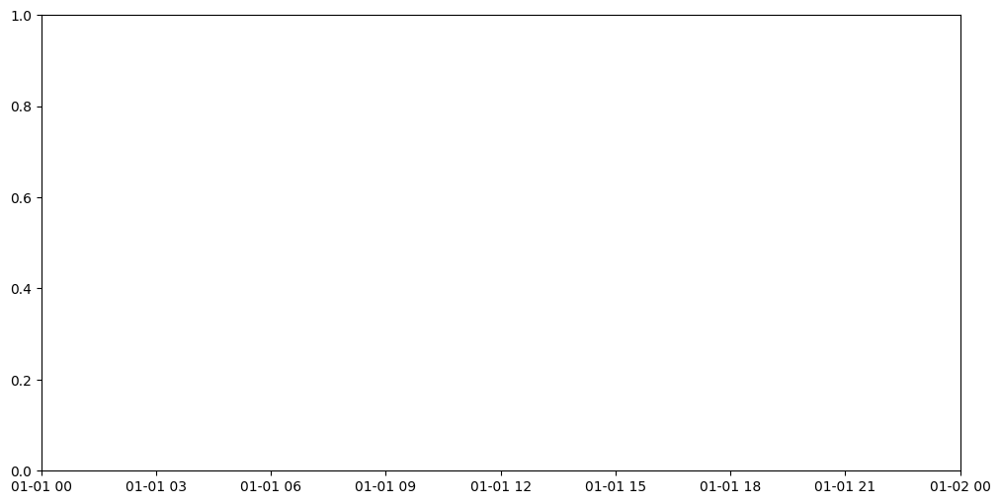

In [47]:
import matplotlib.pyplot as plt

# Configurar el tamaño del gráfico
plt.figure(figsize=(12, 6))

# Establecer los valores de X e Y
fechas = incomes2['Fecha']
gastos = incomes2['Ingresos']

# Crear el gráfico de barras
plt.bar(fechas, ingresos)

# Configurar los límites del eje Y
plt.ylim(0, 5000)

# Rotar las etiquetas del eje X para una mejor visualización
plt.xticks(rotation=45)

# Etiquetas y título
plt.xlabel('Fecha')
plt.ylabel('Gastos')
plt.title('Gráfico de Ingresos a lo largo del tiempo')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

In [ ]:
valores_unicos_con_gastos = expences['Concepto'].unique().tolist()
valores_unicos_con_gastos

In [ ]:
# Lista de valores únicos que deseas mantener
valores_deseados = ['efectivo',
 'gasolina',
 'movimientos_interno',
 'restaurantes',
 'seguros',
 'colegios',
 'gym',
 'comida',
 'movil_internet',
 'Transferencia de ING DIRECT',
 'parking',
 'casa',
 'ong',
 'terapiasOli',
 'agua',
 'farmacia',
 'pago_con_tarjeta',
 'energia',
 'moda',
 'Transferencia emitida (NOVIEMBRE Y',
 'belleza',
 'Transferencia emitida periódica',
 'Recibo Xfera Moviles S.A.',
 'gastos_varios',
 'Transferencia emitida (TRANSFERENCIA',
 'Transferencia emitida (REGALITO',
 'tarjetas',
 'Transferencia emitida (ENERO 2013)',
 'Transferencia emitida (VALE)',
 'gastos_compras',
 'coches',
 'Transferencia emitida (FEBRERO)',
 'ahorro',
 'Transferencia emitida (MARZO)',
 'Transferencia emitida (DESPEDIDA',
 'Transferencia emitida (REPARACION',
 'Transferencia emitida (ABRIL)',
 'Moda',
 'Transferencia emitida (MUCHAS',
 'Gastos/ingreso_valen',
 'Transferencia emitida (RESERVA',
 'Transferencia emitida (GASTOS EN',
 'Transferencia de cuenta',
 'alquiler',
 'Transferencia emitida (IBI)',
 'Alquiler',
 'Transferencia emitida (CORDON',
 'Transferencia emitida (PRÉSTAMO)',
 'Cargo por domiciliación',
 'Transferencia emitida (SIMPUESTOS',
 'hipoteca',
 'impuestos',
 'Transferencia emitida (VALORACIÓN',
 'Transferencia emitida (QUE SEAIS MUY',
 'limpieza',
 'viaje',
 'Transferencia emitida (25',
 'ocio',
 'Transferencia devuelta',
 'Transferencia emitida (CALENDARIOS',
 'Gastos/ingreso_oli',
 'Transferencia emitida (VESTIDO BODA)',
 'MJ',
 'Transferencia emitida (BAILARINAS Y',
 'Transferencia emitida (CORTES',
 'Cargo de tasación',
 'Transferencia emitida (SANDALIAS Y',
 'viajes',
 'Transferencia emitida (PANTALONES Y',
 'Transferencia emitida (PLUMAS)',
 'Transferencia emitida',
 'Transferencia emitida (MAMA)',
 'Transferencia emitida (PATRULLA',
 'Transferencia emitida (CONTORNO DE',
 'Transferencia emitida (SUDADERAS',
 'Transferencia emitida (ADUANA)',
 'Transferencia emitida (FISIO RESPI)',
 'Transferencia emitida (MOVIMIENTO',
 'Transferencia emitida (MOCASINES',
 'Transferencia emitida (DEVOLUCION',
 'Transferencia emitida (DEVOLUCION)',
 'Transferencia emitida (PARAGUAS Y',
 'Transferencia emitida (LONDRES)',
 'Transferencia emitida (ZOO FAMILIA',
 'Transferencia emitida (INSCRIPCION',
 'Transferencia emitida (FISIO JUNIO',
 'Transferencia emitida (LIBROS Y CUOTA',
 'Transferencia emitida (PEDIDO',
 'Transferencia emitida (ASIENTO',
 'Transferencia emitida (BANESTO)',
 'Transferencia emitida (PRESTAMO)',
 'Transferencia emitida (OCTUBRE)',
 'Transferencia emitida (PANTALONES',
 'Transferencia emitida (JUGUETES)',
 'Transferencia emitida (NOVIEMBRE)',
 'Transferencia emitida (JAMONCITO)',
 'Transferencia emitida (REGALOS PAPÁ)',
 'Suscripción de Fondos',
 'movilidad',
 'Transferencia emitida (ENERO)',
 'Transferencia emitida (MULTA)',
 'Transferencia emitida (DEVOLUCIÓN)',
 'Transferencia emitida (JAMONCITO',
 'Transferencia emitida (REGALOS',
 'Transferencia emitida (MAYO)',
 'Transferencia emitida (DEVOLUCIÓN',
 'Transferencia emitida (JUNIO)',
 'Transferencia emitida (ALEJANDRA',
 'Transferencia emitida (TRICICLO NUM',
 'Transferencia emitida (COMPRA LIBROS',
 'Transferencia emitida (ALTA FAMILIA',
 'Transferencia emitida (AGOSTO)',
 'Transferencia emitida (QUE BIEN LO',
 'Transferencia emitida (SEPTIEMBRE)',
 'Intereses deudores',
 'Transferencia emitida (CHAQUETA',
 'loteria',
 'Transferencia emitida (FORMALIZACION',
 'Cheque bancario',
 'Provisión de fondos gestoría',
 'Transferencia emitida (NÚMERO DE',
 'Recibo NATIONALE NEDERLANDEN',
 'Transferencia emitida (2018-92)',
 'Transferencia emitida (OBRAS CASA',
 'Transferencia emitida (PLUSVALÍA',
 'Transferencia emitida (PENDIENTE',
 'Transferencia emitida (PEDIDO 316083',
 'Transferencia emitida (FACTURA 2018-',
 'Transferencia emitida (PRIMERA TANDA',
 'Transferencia emitida (LAREDO)',
 'Transferencia emitida (PEGATINAS 22Q',
 'Transferencia emitida (CUOTA SOCIO',
 'Recibo UNIVERSIDAD EUROPEA DE',
 'Recibo LAURA G. DOLLA',
 'Transferencia emitida (SEGUNDA',
 'Transferencia emitida (COMPRA DE',
 'Transferencia emitida (CORTIJADA',
 'Transferencia emitida (PRIMERA CUOTA',
 'Transferencia emitida (TERCERA TANDA',
 'autonomo',
 'Transferencia emitida (MERCADILLO)',
 'Recibo LOTUNE GESTION SL (KidsANDUs',
 'Transferencia emitida (REGALOS BORJA',
 'Transferencia emitida (IBI 2018 FAMILIA',
 'Transferencia emitida (MAQUILLAJE Y',
 'Transferencia emitida (ACEITE)',
 'Recibo HUBSIDE',
 'Transferencia emitida (COLONIA',
 'coche',
 'Transferencia emitida (VALENTIN',
 'Transferencia emitida (RESERVA DE',
 'Transferencia emitida (CREMA',
 'Transferencia emitida (BOTAS Y',
 'Transferencia emitida (EDREDÓN Y',
 'Recibo MARIA PILAR LAGUNA HURTADO',
 'Transferencia emitida (031905 2017',
 'Transferencia emitida (COMIDA',
 'Transferencia emitida (COMPRA',
 'Transferencia emitida (41 MIOS Y 8 DE',
 'Transferencia emitida (VAQUEROS Y',
 'Transferencia emitida (FACTURA 112',
 'Transferencia emitida (GESTIÓN SEPE)',
 'Transferencia emitida (GRACIAS)',
 'oposiciones',
 'Transferencia emitida (TERAPIA',
 'Transferencia emitida (ACTIVIDAD',
 'Transferencia emitida (MATRICULA',
 'Recibo ASES.JURID.ADMON.FINCAS',
 'Transferencia emitida (1A SEMANA',
 'Transferencia emitida (JORNADAS',
 'Transferencia emitida (REIN',
 'Transferencia emitida (EXCURSION',
 'Transferencia emitida (VALENTÍN',
 'Transferencia emitida (PEDIDO NUM',
 'Recibo COMERCIALIZADORA REGULADA,',
 'Recibo IGNACIO GARCIA PEREA',
 'Transferencia emitida (2A SEMANA',
 'Transferencia emitida (3A SEMANA',
 'Transferencia emitida (LIBRO Y CUOTA',
 'Transferencia emitida (2823288982178',
 'Transferencia emitida (2823288982077',
 'Transferencia emitida (2823288982279',
 'Transferencia emitida (2823288981976',
 'Transferencia emitida (REIN 031905',
 'Recibo REPARADORAS SAGRADO',
 'Transferencia emitida (330 SESIONES',
 'Cargo en cuenta']

# Filtra el DataFrame para quedarte solo con los valores deseados
expences2 = expences[expences['Concepto'].isin(valores_deseados)]


In [48]:
df_final.describe(include='object')

,Concepto,Fecha_Valor,detalle
count,12787,12787,12787
unique,207,3237,2900
top,movimientos_interno,27-07-2023,Transferencia recibida
freq,1358,40,666


In [49]:
conteo_valores = df_final['Concepto'].value_counts()
print(conteo_valores)

Concepto
movimientos_interno                        1358
gastos_varios                              1279
comida                                     1119
Transferencia recibida                      666
restaurantes                                636
ahorro                                      633
seguros                                     532
tarjetas                                    510
pago_con_tarjeta                            495
gasolina                                    401
terapiasOli                                 339
ong                                         318
efectivo                                    315
belleza                                     302
gym                                         295
parking                                     276
farmacia                                    269
energia                                     261
gastos_compras                              253
casa                                        244
limpieza                       

In [50]:
import pandas as pd

# Contar la cantidad de veces que aparece cada concepto
conteo_valores = df_final['Concepto'].value_counts()

# Filtrar los conceptos con menos de 15 valores
conceptos_pocos_valores = conteo_valores[conteo_valores < 15].index

# Cambiar el nombre de los conceptos con menos de 15 valores a "indefinido"
df_final.loc[df_final['Concepto'].isin(conceptos_pocos_valores), 'Concepto'] = 'indefinido'

# Mostrar el nuevo conteo de valores
conteo_valores_actualizado = df_final['Concepto'].value_counts()
print(conteo_valores_actualizado)


Concepto
movimientos_interno                      1358
gastos_varios                            1279
comida                                   1119
Transferencia recibida                    666
restaurantes                              636
ahorro                                    633
seguros                                   532
tarjetas                                  510
pago_con_tarjeta                          495
gasolina                                  401
terapiasOli                               339
indefinido                                318
ong                                       318
efectivo                                  315
belleza                                   302
gym                                       295
parking                                   276
farmacia                                  269
energia                                   261
gastos_compras                            253
casa                                      244
limpieza                 

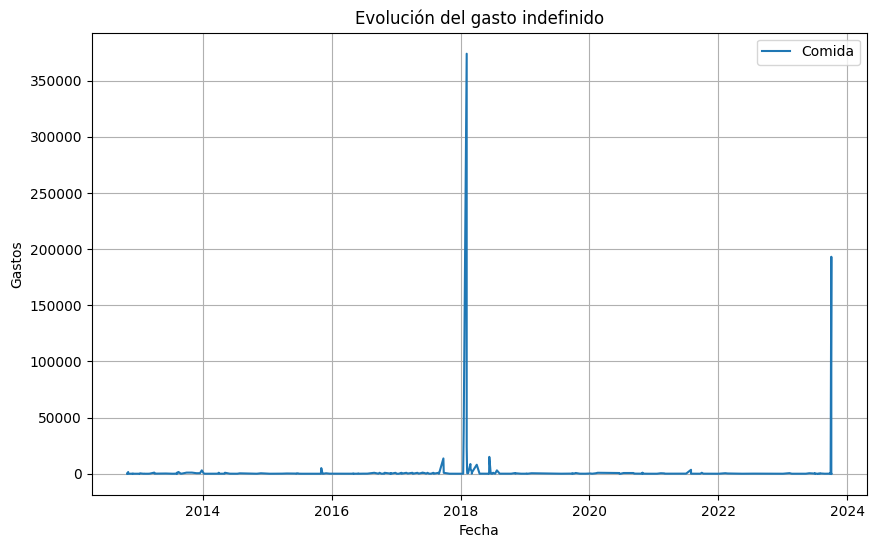

In [51]:
import matplotlib.pyplot as plt

# Filtra las filas donde el Concepto sea "comida"
comida_df = df_final[df_final['Concepto'] == 'indefinido']

# Ordena las filas por la columna 'Fecha'
comida_df = comida_df.sort_values(by='Fecha')

# Crea un gráfico de línea
plt.figure(figsize=(10, 6))
plt.plot(comida_df['Fecha'], comida_df['Gastos'], label='Comida')
plt.xlabel('Fecha')
plt.ylabel('Gastos')
plt.title('Evolución del gasto indefinido')
plt.legend()
plt.grid(True)

# Muestra el gráfico
plt.show()



In [52]:
!pip install scikit-learn

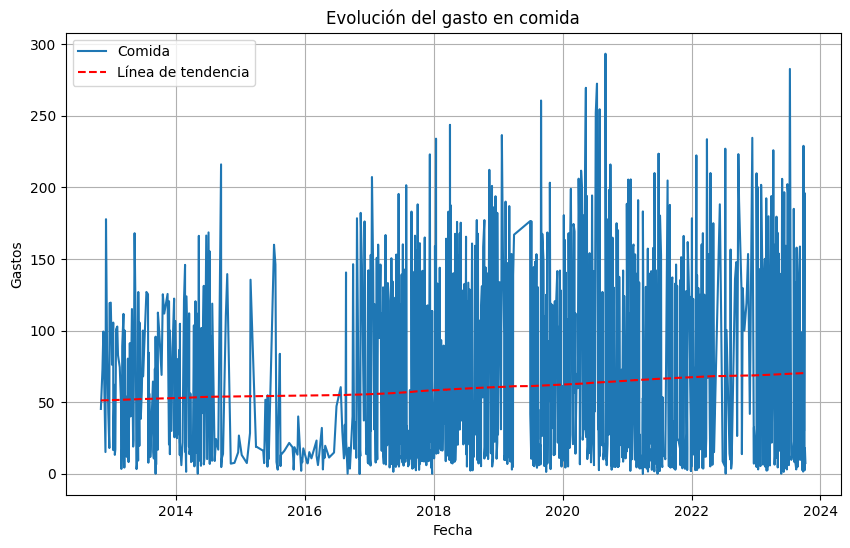

In [53]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression

# Filtra las filas donde el Concepto sea "comida"
comida_df = df_final[df_final['Concepto'] == 'comida']

# Ordena las filas por la columna 'Fecha'
comida_df = comida_df.sort_values(by='Fecha')

# Crea un gráfico de línea
plt.figure(figsize=(10, 6))
plt.plot(comida_df['Fecha'], comida_df['Gastos'], label='Comida')
plt.xlabel('Fecha')
plt.ylabel('Gastos')
plt.title('Evolución del gasto en comida')

# Ajusta una regresión lineal a los datos
X = np.arange(len(comida_df)).reshape(-1, 1)
y = comida_df['Gastos'].values
reg = LinearRegression().fit(X, y)

# Calcula la línea de tendencia
tendencia = reg.coef_ * X + reg.intercept_

# Agrega la línea de tendencia al gráfico
plt.plot(comida_df['Fecha'], tendencia, linestyle='--', color='red', label='Línea de tendencia')

plt.legend()
plt.grid(True)

# Muestra el gráfico
plt.show()


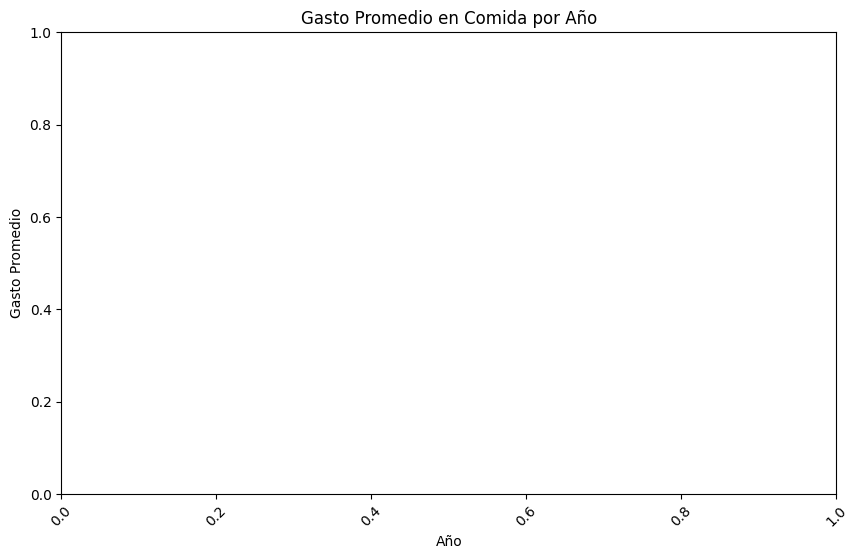

In [56]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('comida', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].mean()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color="Gastos")
plt.title('Gasto Promedio en Comida por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()


In [57]:
import matplotlib.pyplot as plt

# Crear un gráfico de líneas
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='line', marker='o', color='skyblue', linestyle='-', linewidth=2, markersize=8)
plt.title('Gasto Promedio en Comida por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.grid(True)  # Agregar una cuadrícula
plt.show()


TypeError: line() got an unexpected keyword argument 'marker'

<Figure size 1000x600 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('restaurantes', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].mean()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en restaurantes por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('gasolina', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].mean()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en gasolina por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('gasolina', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en gasolina por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('gasolina', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras con color fijo
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar')
plt.title('Gasto Promedio en gasolina por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)

# Mostrar el gráfico en el Jupyter Notebook
plt.show()
#En este código, establecemos el color de las barras en 'skyblue' directamente en el parámetro color. Asegúrate de que el color que deseas utilizar esté definido correctamente en el formato adecuado.









In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('terapiasOli', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en terapias Oli por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('belleza', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en estetica por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('farmacia', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en farmacia por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('gym', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.month)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en deporte por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('seguros', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en seguros por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('colegios', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en educacion por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('energia', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en farmacia por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('gastos_varios', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en varios por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('movimientos_internos', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en compras por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_comida_por_anio = df_final[df_final['Concepto'].str.contains('energia', case=False, regex=True)]

# Agrupar por año y calcular el promedio de gastos
gasto_promedio_comida_por_anio = gasto_comida_por_anio.groupby(gasto_comida_por_anio['Fecha'].dt.year)['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(10, 6))
gasto_promedio_comida_por_anio.plot(kind='bar', color='skyblue')
plt.title('Gasto Promedio en farmacia por Año')
plt.xlabel('Año')
plt.ylabel('Gasto Promedio')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_farmacia_por_mes = df_final[df_final['Concepto'].str.contains('farmacia', case=False, regex=True)]

# Obtener el mes y año de la fecha
gasto_farmacia_por_mes['Mes'] = gasto_farmacia_por_mes['Fecha'].dt.strftime('%Y-%m')

# Agrupar por mes y calcular la suma de los gastos
gasto_total_farmacia_por_mes = gasto_farmacia_por_mes.groupby('Mes')['Gastos'].sum()

# Crear un gráfico de barras
plt.figure(figsize=(14, 6))
gasto_total_farmacia_por_mes.plot(kind='bar', color='skyblue')
plt.title('Gasto Total en Farmacia por Mes')
plt.xlabel('Mes')
plt.ylabel('Gasto Total')
plt.xticks(rotation=45)
plt.show()
# Ajustar el tamaño de la fuente del eje x
plt.xticks(rotation=45, fontsize=0.5)  # Ajusta el tamaño de fuente a tu preferencia


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_farmacia_por_mes = df_final[df_final['Concepto'].str.contains('farmacia', case=False, regex=True)]

# Obtener el mes y año de la fecha
gasto_farmacia_por_mes['Mes'] = gasto_farmacia_por_mes['Fecha'].dt.strftime('%Y-%m')

# Agrupar por mes y calcular la suma de los gastos
gasto_total_farmacia_por_mes = gasto_farmacia_por_mes.groupby('Mes')['Gastos'].sum()

# Crear un gráfico de línea
plt.figure(figsize=(14, 6))
plt.plot(gasto_total_farmacia_por_mes.index, gasto_total_farmacia_por_mes.values, marker='o', linestyle='-')
plt.title('Gasto Total en Farmacia por Mes')
plt.xlabel('Mes')
plt.ylabel('Gasto Total')

# Ajustar el tamaño de la fuente del eje x
plt.xticks(rotation=45, fontsize=8)  # Ajusta el tamaño de fuente a tu preferencia

plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_farmacia_por_mes = df_final[df_final['Concepto'].str.contains('comida', case=False, regex=True)]

# Obtener el mes y año de la fecha
gasto_farmacia_por_mes['Mes'] = gasto_farmacia_por_mes['Fecha'].dt.strftime('%Y-%m')

# Agrupar por mes y calcular la suma de los gastos
gasto_total_farmacia_por_mes = gasto_farmacia_por_mes.groupby('Mes')['Gastos'].sum()

# Crear un gráfico de línea
plt.figure(figsize=(14, 6))
plt.plot(gasto_total_farmacia_por_mes.index, gasto_total_farmacia_por_mes.values, marker='o', linestyle='-')
plt.title('Gasto Total en comida por Mes')
plt.xlabel('Mes')
plt.ylabel('Gasto Total')

# Ajustar el tamaño de la fuente del eje x
plt.xticks(rotation=45, fontsize=8)  # Ajusta el tamaño de fuente a tu preferencia
# Mostrar solo cada 4 meses en la leyenda del eje x
x_ticks = np.arange(0, len(gasto_total_farmacia_por_mes.index), 4)
plt.xticks(x_ticks, [gasto_total_farmacia_por_mes.index[i] for i in x_ticks])

plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_farmacia_por_mes = df_final[df_final['Concepto'].str.contains('gasolina', case=False, regex=True)]

# Obtener el mes y año de la fecha
gasto_farmacia_por_mes['Mes'] = gasto_farmacia_por_mes['Fecha'].dt.strftime('%Y-%m')

# Agrupar por mes y calcular la suma de los gastos
gasto_total_farmacia_por_mes = gasto_farmacia_por_mes.groupby('Mes')['Gastos'].sum()

# Crear un gráfico de línea
plt.figure(figsize=(14, 6))
plt.plot(gasto_total_farmacia_por_mes.index, gasto_total_farmacia_por_mes.values, marker='o', linestyle='-')
plt.title('Gasto Total en comida por Mes')
plt.xlabel('Mes')
plt.ylabel('Gasto Total')

# Ajustar el tamaño de la fuente del eje x
plt.xticks(rotation=45, fontsize=8)  # Ajusta el tamaño de fuente a tu preferencia
# Mostrar solo cada 4 meses en la leyenda del eje x
x_ticks = np.arange(0, len(gasto_total_farmacia_por_mes.index), 4)
plt.xticks(x_ticks, [gasto_total_farmacia_por_mes.index[i] for i in x_ticks])

plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Filtrar datos relacionados con la categoría de comida
gasto_farmacia_por_mes = df_final[df_final['Concepto'].str.contains('movimientos_interno', case=False, regex=True)]

# Obtener el mes y año de la fecha
gasto_farmacia_por_mes['Mes'] = gasto_farmacia_por_mes['Fecha'].dt.strftime('%Y-%m')

# Agrupar por mes y calcular la suma de los gastos
gasto_total_farmacia_por_mes = gasto_farmacia_por_mes.groupby('Mes')['Gastos'].sum()

# Crear un gráfico de línea
plt.figure(figsize=(14, 6))
plt.plot(gasto_total_farmacia_por_mes.index, gasto_total_farmacia_por_mes.values, marker='o', linestyle='-')
plt.title('Gasto Total en comida por Mes')
plt.xlabel('Mes')
plt.ylabel('Gasto Total')

# Ajustar el tamaño de la fuente del eje x
plt.xticks(rotation=45, fontsize=8)  # Ajusta el tamaño de fuente a tu preferencia
# Mostrar solo cada 4 meses en la leyenda del eje x
x_ticks = np.arange(0, len(gasto_total_farmacia_por_mes.index), 4)
plt.xticks(x_ticks, [gasto_total_farmacia_por_mes.index[i] for i in x_ticks])

plt.show()


In [ ]:
!pip install openpyxl

In [ ]:
!pip install seaborn

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Contar la cantidad de veces que aparece cada concepto
conteo_conceptos = df_final['Concepto'].value_counts().reset_index()
conteo_conceptos.columns = ['Concepto', 'Cantidad']

# Crear un boxplot basado en la cantidad de veces que aparece cada concepto
plt.figure(figsize=(10, 6))
sns.boxplot(x='Cantidad', data=conteo_conceptos, palette="Set3")
plt.xlabel('Cantidad de Veces')
plt.title('Boxplot de Cantidad de Veces que Aparece Cada Concepto')
plt.xticks(rotation=90)
plt.show()


In [ ]:
conteo_conceptos.describe()

In [ ]:
maximo_gastos = df_final['Gastos'].max()
print("El valor máximo en la columna Gastos es:", maximo_gastos)


In [ ]:
maximo_gastos = df_final['Gastos'].max()
df_final = df_final[df_final['Gastos'] < maximo_gastos]


In [ ]:
maximo_gastos = df_final['Gastos'].max()
print("El valor máximo en la columna Gastos es:", maximo_gastos)

In [ ]:
maximo_gastos = df_final['Gastos'].max()
df_final = df_final[df_final['Gastos'] < maximo_gastos]
